In [73]:
import os
import layoutparser as lp
import cv2
import matplotlib.pyplot as plt

BASE_PATH = "../data/"

def detect_layout(image_path, roi_threshold=0.2):

    # Load the pre-trained model
    image = cv2.imread(image_path)
    image = image[..., ::-1]
    model_config = "lp://PubLayNet/faster_rcnn_R_50_FPN_3x/config"
    # lp://PubLayNet/faster_rcnn_R_50_FPN_3x/config
    # lp://PubLayNet/mask_rcnn_X_101_32x8d_FPN_3x/config
    model = lp.Detectron2LayoutModel(model_config,
                                    extra_config=["MODEL.ROI_HEADS.SCORE_THRESH_TEST", roi_threshold],
                                    #label_map={0: "Text", 1: "Title", 2: "List", 3: "Table", 4:"Figure"}
                                    )
    layout = model.detect(image)
    # Detect the layout of the input image

    return lp.draw_box(image, layout, box_width=3), layout
# Show the detected layout of the input image

def bounding_boxes(image_path, layout):

    image = cv2.imread(image_path)
    image = image[..., ::-1]
    # Extract bounding boxes
    bounding_boxes = [block.block for block in layout]

    # Optionally extract coordinates as tuples (x1, y1, x2, y2)
    bbox_coords = [b.coordinates for b in bounding_boxes]

    # If you want them as integers:
    bbox_coords = [tuple(map(int, b.coordinates)) for b in bounding_boxes]

    # Print results
    for i, bbox in enumerate(bbox_coords):
        print(f"Block {i+1}: {bbox}")

    # Get all coordinates
    all_coords = [b.block.coordinates for b in layout]

    # Compute enclosing boundary
    x1 = int(min(b[0] for b in all_coords))
    y1 = int(min(b[1] for b in all_coords))
    x2 = int(max(b[2] for b in all_coords))
    y2 = int(max(b[3] for b in all_coords))

    outer_boundary = (x1, y1, x2, y2)
    print("Outer boundary:", outer_boundary)

    # Draw rectangle on image
    image_with_boundary = image.copy()
    cv2.rectangle(image_with_boundary, (x1, y1), (x2, y2), (0, 0, 255), 3)

    plt.imshow(image_with_boundary)
    plt.axis('off')
    plt.show()


Block 1: (27, 74, 3992, 2859)
Outer boundary: (27, 74, 3992, 2859)


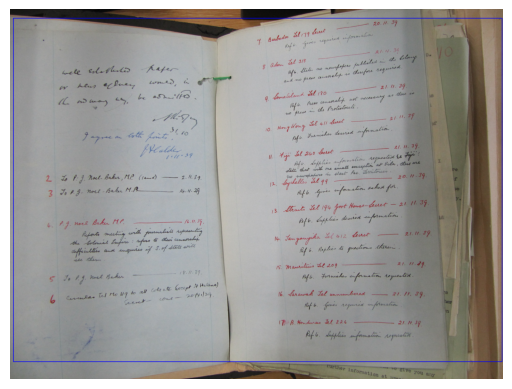

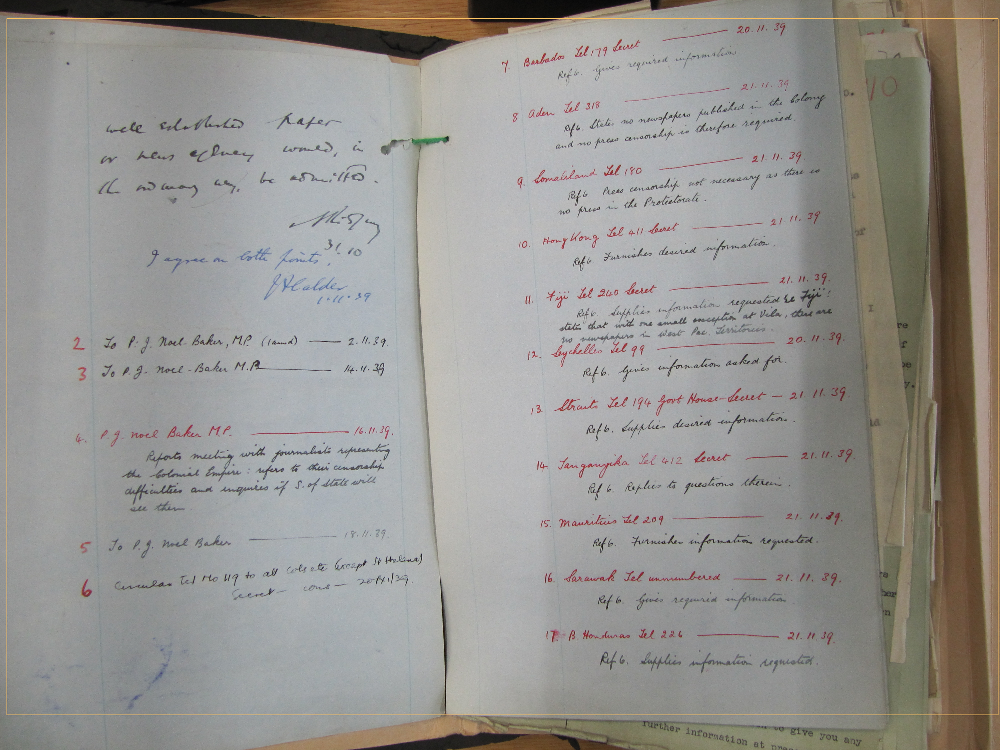

In [84]:
pred_image, lt = detect_layout(BASE_PATH + "two_sides_0.JPG", 0.4)
bounding_boxes(BASE_PATH + "two_sides_0.JPG", lt)
pred_image

Block 1: (114, 67, 2955, 3425)
Block 2: (0, 1629, 2973, 3958)
Outer boundary: (0, 67, 2973, 3958)


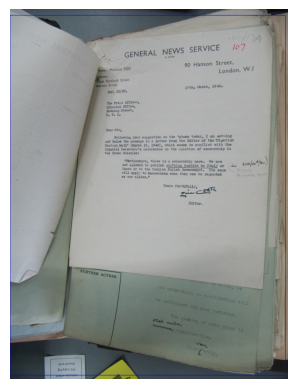

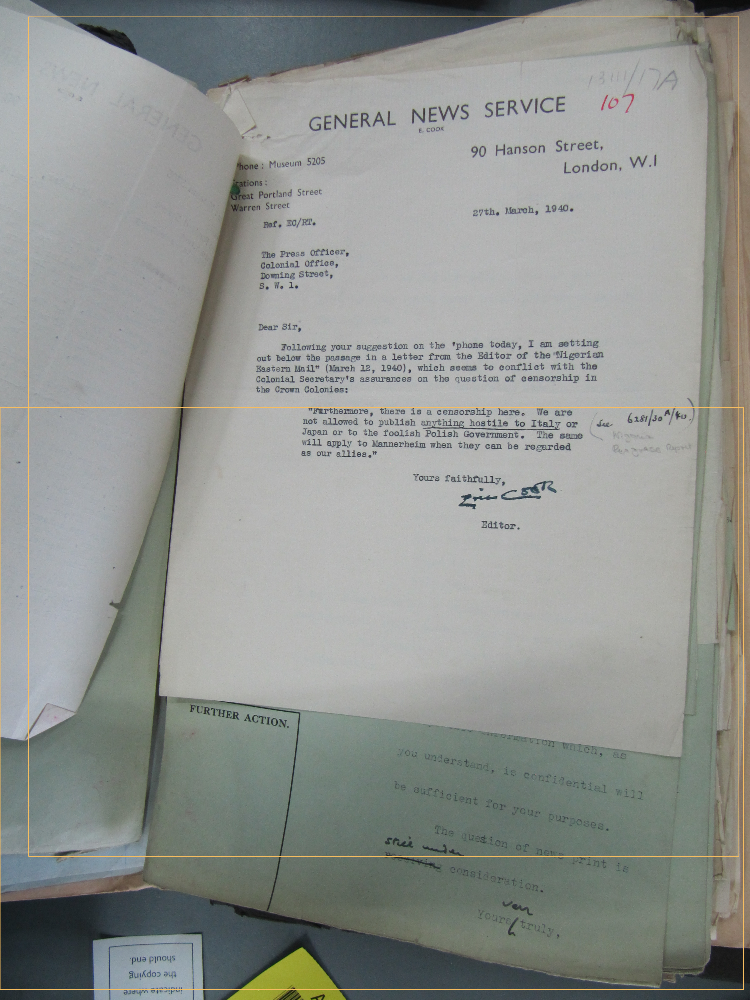

In [77]:
pred_image, lt = detect_layout(BASE_PATH + "two_sides_1.JPG" , 0.8)
bounding_boxes(BASE_PATH + "two_sides_1.JPG", lt)
pred_image

Block 1: (60, 38, 1692, 2323)
Block 2: (91, 1219, 1656, 2633)
Block 3: (94, 1888, 1309, 2636)
Block 4: (65, 75, 1650, 1251)
Block 5: (87, 124, 1484, 552)
Outer boundary: (60, 38, 1692, 2636)


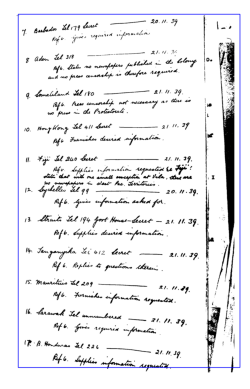

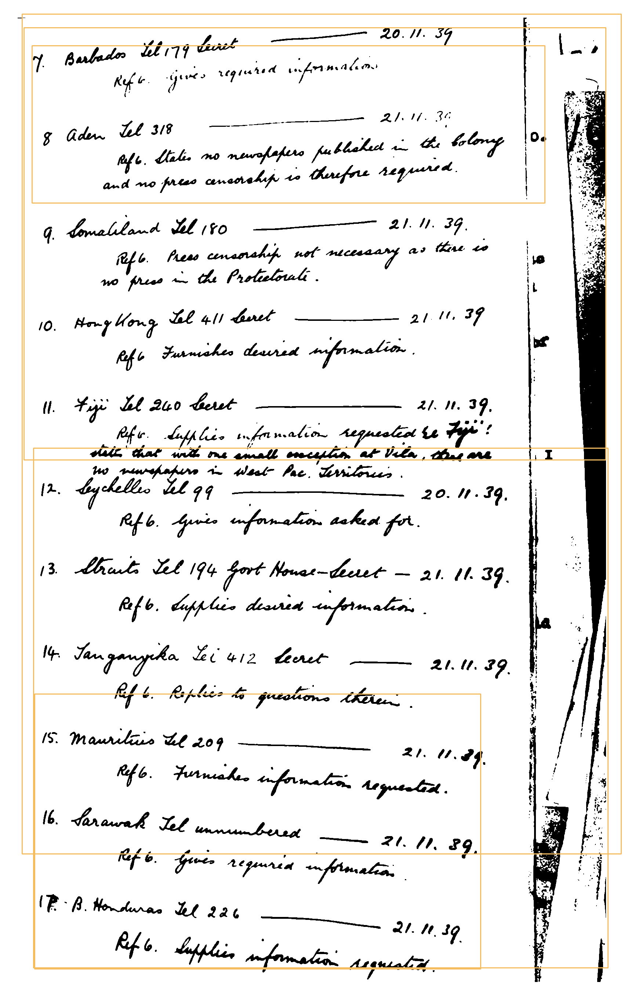

In [79]:
pred_image, lt = detect_layout(BASE_PATH + "one_side_0.tif", 0.2)
bounding_boxes(BASE_PATH + "one_side_0.tif", lt)
pred_image

Block 1: (145, 64, 1402, 986)
Block 2: (67, 1081, 1358, 1959)
Block 3: (153, 1288, 1343, 1592)
Block 4: (65, 16, 1369, 1926)
Block 5: (167, 60, 1277, 395)
Block 6: (91, 914, 1317, 1097)
Block 7: (297, 216, 1323, 760)
Block 8: (79, 916, 1345, 1098)
Block 9: (766, 415, 1296, 834)
Block 10: (165, 1306, 1309, 1596)
Block 11: (1311, 171, 1414, 239)
Block 12: (157, 1851, 1395, 1980)
Block 13: (75, 919, 1310, 1096)
Outer boundary: (65, 16, 1414, 1980)


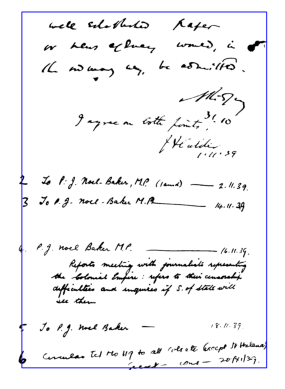

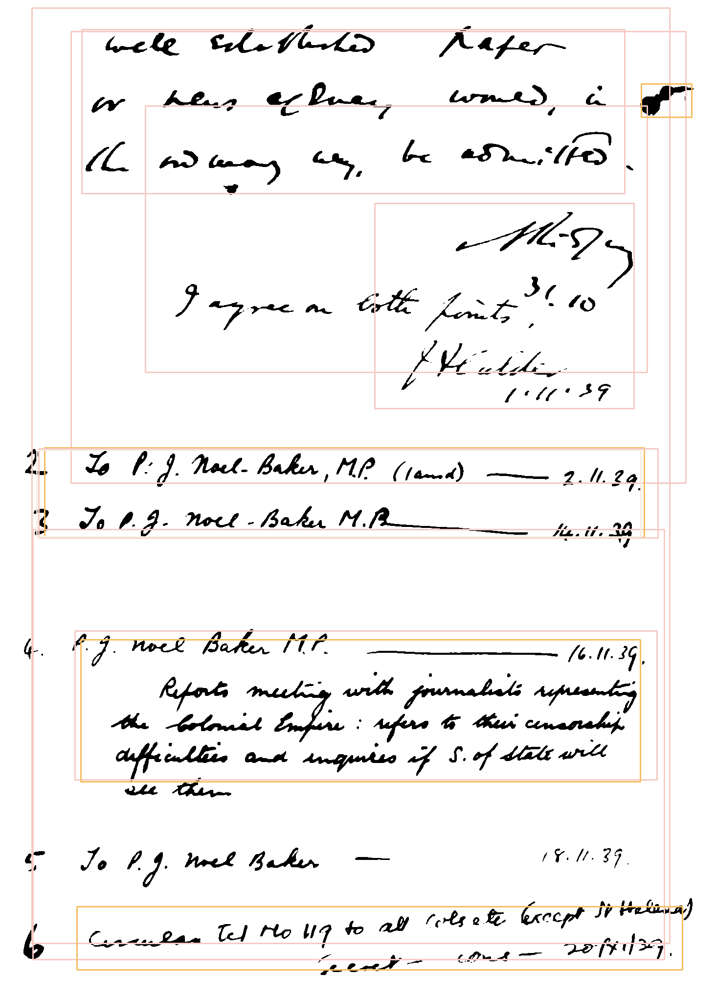

In [82]:
pred_image, lt = detect_layout(BASE_PATH + "one_side_1.tif", 0.05)
bounding_boxes(BASE_PATH + "one_side_1.tif", lt)
pred_image

Block 1: (109, 360, 527, 568)
Block 2: (631, 657, 1053, 772)
Block 3: (629, 159, 1044, 363)
Block 4: (104, 573, 519, 769)
Block 5: (634, 512, 1048, 656)
Block 6: (639, 374, 1036, 500)
Block 7: (625, 90, 1043, 157)
Block 8: (203, 131, 457, 199)
Block 9: (175, 93, 519, 353)
Outer boundary: (104, 90, 1053, 772)


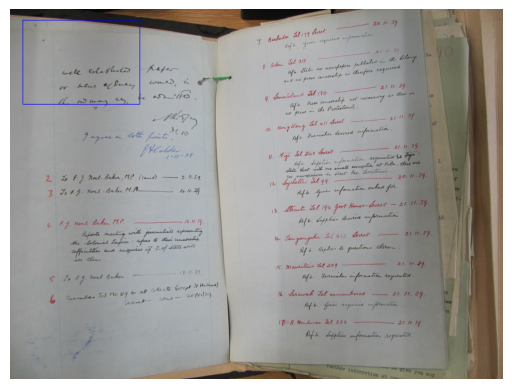

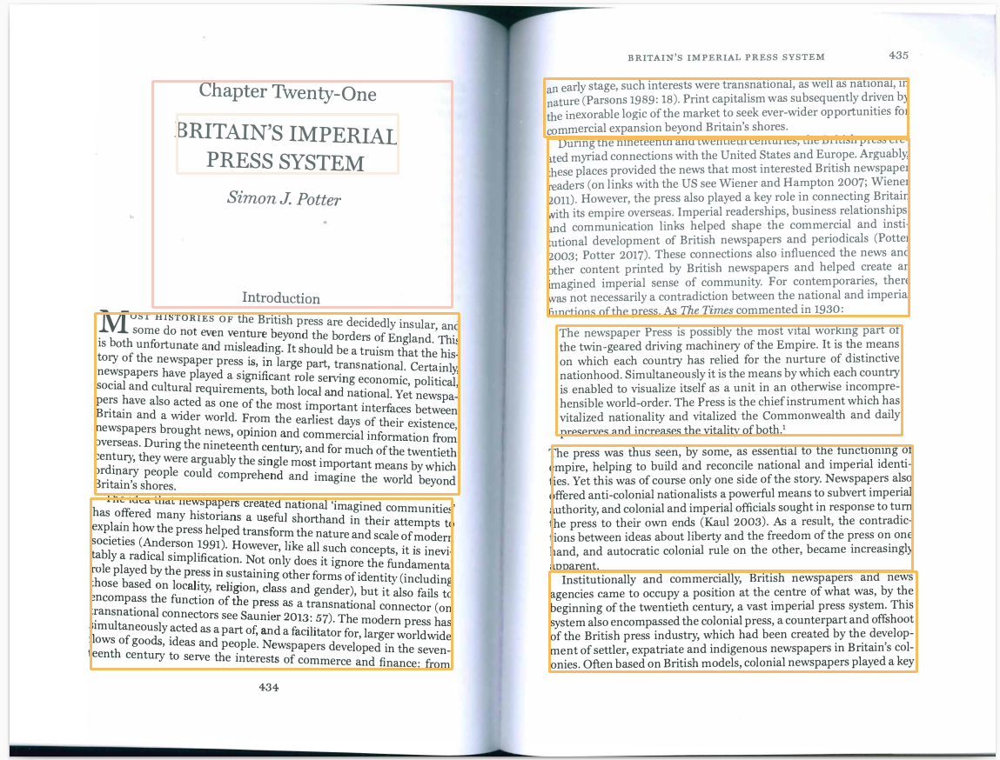

In [85]:
pred_image, lt = detect_layout(BASE_PATH + "two_sides_hp_2.png", 0.4)
bounding_boxes(BASE_PATH + "two_sides_0.JPG", lt)
pred_image